In [3]:
include("src/paramless.jl")

evolve (generic function with 3 methods)

## Experiment 1 - Fitting functions $C^0([0,1])$

In [4]:
using Plots;

In [5]:
function target_function(x::Float64)
    return x^2
end 

target_function (generic function with 1 method)

In [6]:
x = Array(range(-1.0,1.0,length=100));
target = target_function.(x);
initial_surface = zeros(size(x)); # Start with flat line 

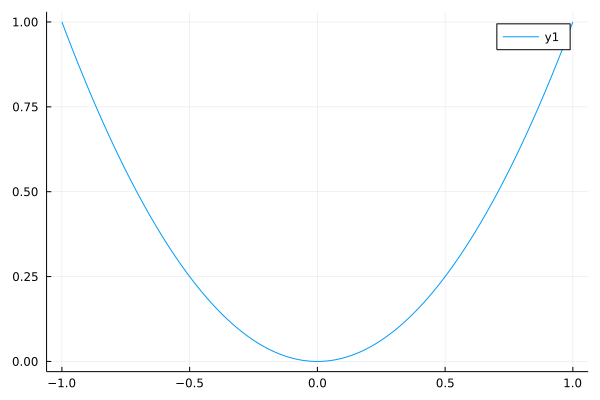

In [7]:
plot(x,target)

### Point Mutation of $f:[-1,1]\to [0,1], f(x) = x^2$

In [8]:
ans, series = evolve(initial_surface, distance_fitness_function, 
point_mutation, 100000; target_surface=target, mutation_epsilon=0.001);

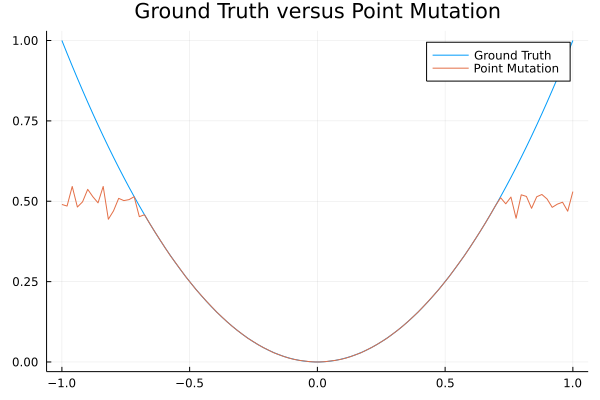

In [9]:
plot(x,[target,ans], title="Ground Truth versus Point Mutation", label = ["Ground Truth" "Point Mutation"])

### Gaussian mutation of $f$

We now attempt a Gaussian mutation which bumps a small region around a randomly selected point.

In [10]:
iterations = 1e4;
mutation_epsilon = 0.01;
width = 0.05;

In [11]:
ans_soft, series_soft = evolve(initial_surface, distance_fitness_function, 
                            gaussian_mutation, iterations, 
                            1e-12, 777; 
                            target_surface=target, mutation_epsilon=mutation_epsilon, 
                            domain=x, width=width);

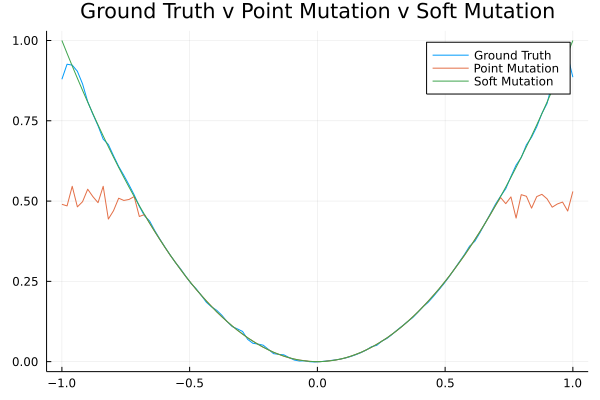

In [12]:
plot(x,[ans_soft, ans, target], title = "Ground Truth v Point Mutation v Soft Mutation", label = ["Ground Truth" "Point Mutation" "Soft Mutation"])

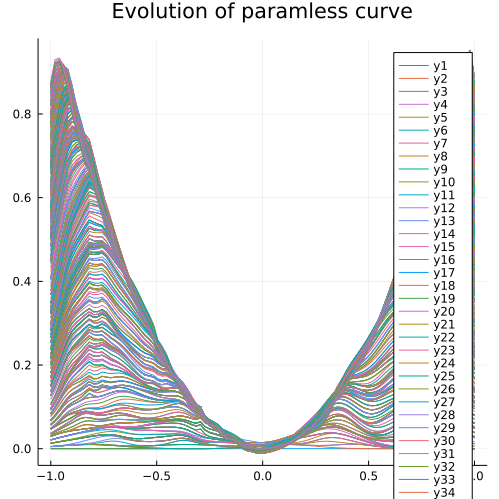

In [13]:
plot(x,[thing[2] for thing = series_soft], title = "Evolution of paramless curve")
plot!(size=(500,500))

#### Gaussian mutation of $f:[-1,1] \to \mathbb{R}, f(x) = \sin(x^3)$

In [14]:
x = Array(range(-1.0,1.0,length=100));
function cubic_sine(x)
    return sin(x^3)
end
target_sine = cubic_sine.(x);

In [15]:
ans_sine, series_sine = evolve(initial_surface, distance_fitness_function, gaussian_mutation, 
                                iterations, 1e-12, 777; 
                                target_surface=target_sine, mutation_epsilon=mutation_epsilon, 
                                domain=x, width=width);

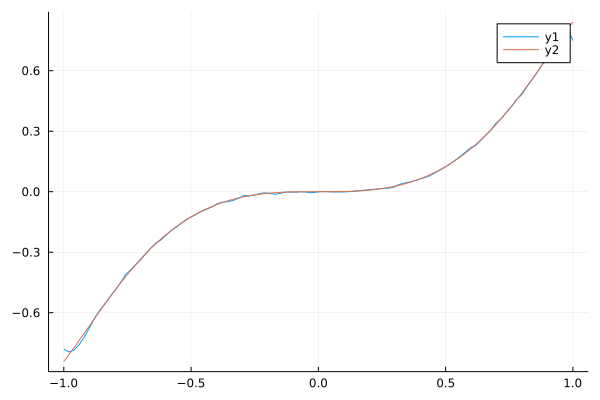

In [15]:
plot(x, [ans_sine, target_sine])

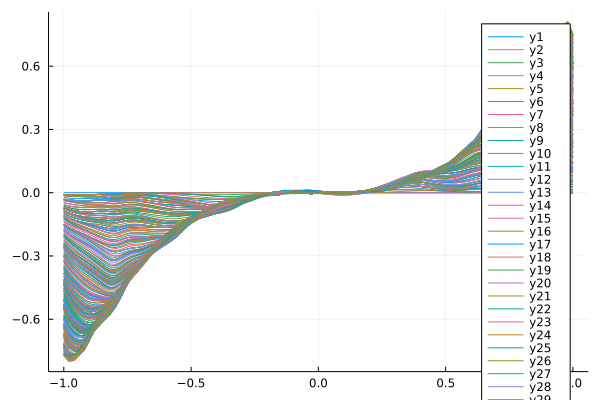

In [57]:
plot(x,[thing[2] for thing = series_sine])

#### Discontinuous function

In [16]:
function heaviside(x) 
    if x < 0.0
        return -0.5
    else 
        return 0.5
    end 
end 

heaviside (generic function with 1 method)

In [17]:
target_discont = heaviside.(x);

In [18]:
ans_disc, series_disc = evolve(initial_surface, distance_fitness_function, gaussian_mutation, 
                                iterations, 1e-12, 777; 
                                target_surface=target_discont, mutation_epsilon=mutation_epsilon, 
                                domain=x, width=width);

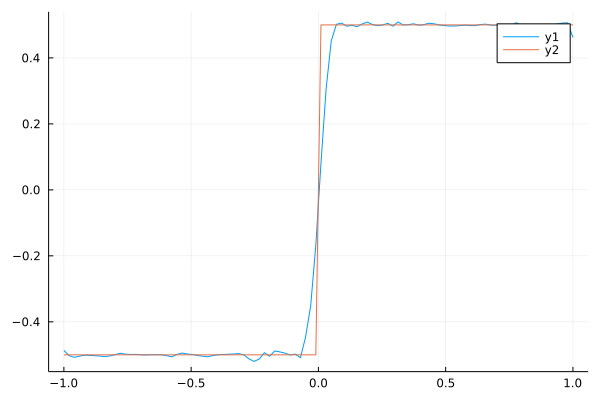

In [20]:
plot(x, [ans_disc, target_discont])

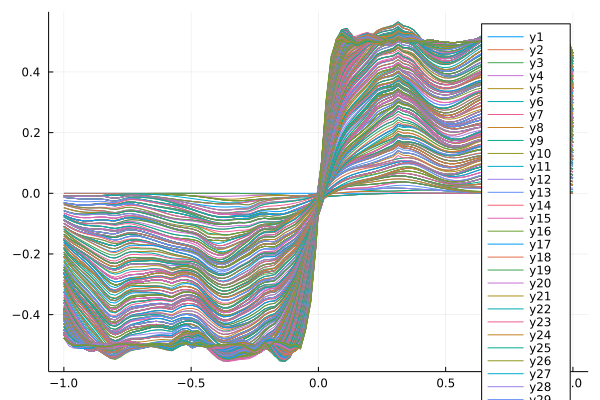

In [21]:
plot(x,[thing[2] for thing = series_disc])

## Experiment 2: Evolution of seasonal flowering strategies

In [21]:
using NumericalIntegration;
include("src/flowering.jl")

flowering_fitness (generic function with 1 method)

In [19]:
domain = Array(range(0.001,1.0,length=100));

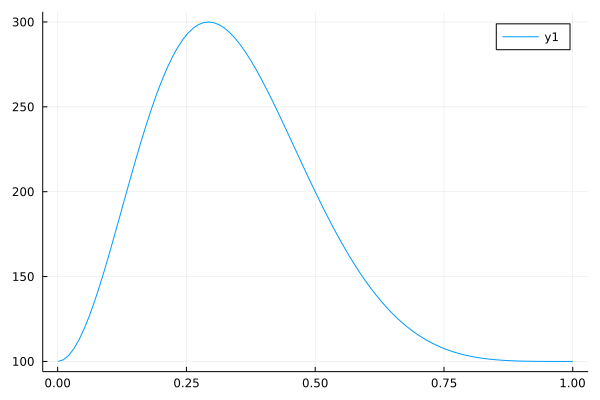

In [22]:
plot(domain,k.(domain))

In [23]:
initial_surface = ones(size(domain));
number_of_generations = 1e5

100000.0

In [24]:
ans, series = evolve(initial_surface, 
                    flowering_fitness,
                     gaussian_mutation_distribution,
                     number_of_generations;
                     mutation_epsilon=0.01,
                     domain=domain, 
                     alpha=1.0, beta=0.9, k_function=k,
                     width=0.05);

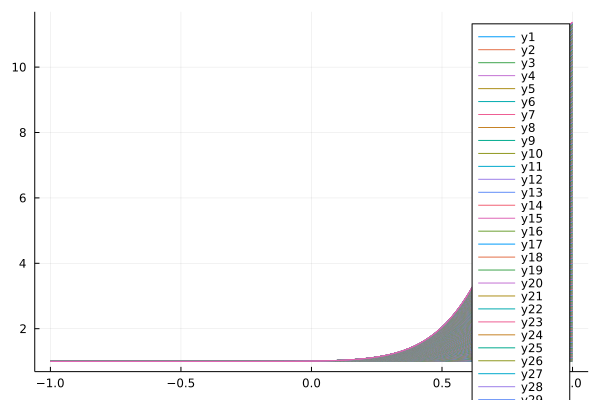

In [25]:
plot(x,[thing[2] for thing = series])

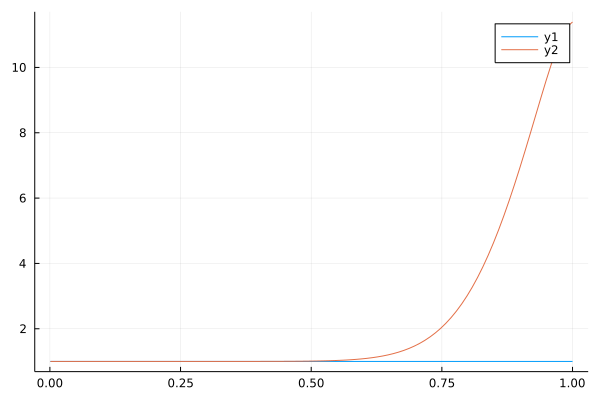

In [80]:
plot(domain, [initial_surface, ans])

In [26]:
integrate(domain,ans, SimpsonEven())

2.3671960393891087

## Experiment 3 - Metabolic investment strategies


In [30]:
include("src/metabolic.jl")

metabolic_fitness (generic function with 1 method)

In [31]:
domain = Array(range(0.001,1.0,length=100));
number_of_generations=5000;
initial_surface = zeros(size(domain));

In [32]:
ans, series = evolve(initial_surface, 
                     metabolic_fitness, 
                     gaussian_mutation,
                     number_of_generations,
                     atol=1e-8;
                     domain=domain,
                     mutation_epsilon=0.01,
                     c=0.5, 
                    width=0.02, lower_bound=0.0);

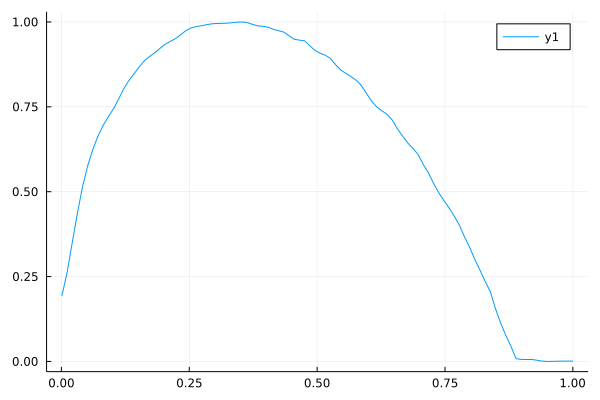

In [33]:
plot(domain, ans)